# BSRNet Trainning, Testing and Evaluating

## 1. Training

In [8]:
from os import listdir
from os.path import join
from pprint import pprint

import yaml
import torch
import matplotlib.pyplot as plt
from Deeplearning.train import Trainer
from scipy.io import savemat
torch.autograd.set_detect_anomaly(True)

ModelRoot = "D:\\Workspace\\Blood Recognition\\models"
ProjectRoot = "D:\\Workspace\\Blood Recognition\\Deeplearning"
PlanLogPath = join(ModelRoot, "plan_8.4")

In [2]:
# Hyperparams
training_param_yamlfname = join(ProjectRoot, "train_hypers.yaml")
with open(training_param_yamlfname, "r") as yamlf:
    hypdict = yaml.load(yamlf, yaml.FullLoader)
pprint(hypdict)

{'anchors': [1.0, 1.0, 1.125, 1.125, 1.25, 1.25, 1.375, 1.375],
 'attention_layer': 7,
 'decay_rate': 1e-05,
 'grid_size': 40,
 'input_channel': 4,
 'lr': 0.001,
 'model_fpath': 'D:\\Workspace\\Blood Recognition\\models\\plan_8.2',
 'n_box': 4,
 'n_cls': 3,
 'train_loader': {'batch_size': 8,
                  'fpath_str': 'D:\\Workspace\\Blood '
                               'Recognition\\datasets\\Set-202109-1',
                  'load_modalities': ['focus', 'phase', 'minus', 'plus'],
                  'shuffle': True,
                  'training_stage': 'train'},
 'valid_loader': {'batch_size': 8,
                  'fpath_str': 'D:\\Workspace\\Blood '
                               'Recognition\\datasets\\Set-202109-1',
                  'load_modalities': ['focus', 'phase', 'minus', 'plus'],
                  'shuffle': True,
                  'training_stage': 'valid'}}


In [2]:
modelFpath = join(ModelRoot, "plan_8.4")
trainer = Trainer(training_param_yamlfname, model_fpath=modelFpath)
modelFilename = trainer.training(100)

Loading data ...

Hyper-parameters:
	lr: 0.001
	n_box: 4
	n_cls: 3
	input_channel: 4
	decay_rate: 1e-05
	grid_size: 40
	attention_layer: 7
	train_loader: {'fpath_str': 'D:\\Workspace\\Blood Recognition\\datasets\\Set-202109-1', 'training_stage': 'train', 'batch_size': 8, 'shuffle': True, 'load_modalities': ['focus', 'phase', 'minus', 'plus']}
	valid_loader: {'fpath_str': 'D:\\Workspace\\Blood Recognition\\datasets\\Set-202109-1', 'training_stage': 'valid', 'batch_size': 8, 'shuffle': True, 'load_modalities': ['focus', 'phase', 'minus', 'plus']}
	model_fpath: D:\Workspace\Blood Recognition\models\plan_8.4
	anchors: [1.0, 1.0, 1.125, 1.125, 1.25, 1.25, 1.375, 1.375]

Model Info
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 8, 320, 320]             288
       BatchNorm2d-2          [-1, 8, 320, 320]              16
               ELU-3          [-1, 8, 320, 320]           

In [2]:
# Check logs
with open(join(PlanLogPath, "losses_1227-171916.yaml"), "r") as yamlf:
    logdict = yaml.load(yamlf, yaml.FullLoader)
pprint(logdict)

{'accuracy': [0.7657657103050695,
              0.7832827729426926,
              0.7901457202940747,
              0.7954477336369236,
              0.7954140470102828,
              0.7985895279980244,
              0.8008476525028924,
              0.8026431281680851,
              0.8013023437958372,
              0.8044856269685339,
              0.8055046869238357,
              0.8064407857859355,
              0.806480810375648,
              0.8085756826083141,
              0.8083956769887958,
              0.8078958641758341,
              0.8059650571709683,
              0.8088149630549236,
              0.8090543446541216,
              0.8114297317193017,
              0.8124466636882437,
              0.8127407648204233,
              0.8124736593147317,
              0.8125061068854623,
              0.8127566325838327,
              0.8117628597638608,
              0.812712700534753,
              0.8118418145876038,
              0.8129798263451384,
              0.

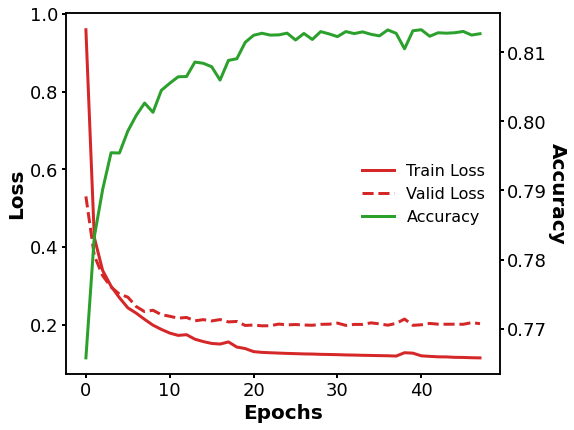

In [7]:
plt.rcParams["axes.linewidth"] = 1.5
plt.rcParams["xtick.labelsize"] = 18
plt.rcParams["ytick.labelsize"] = 18
plt.rcParams["xtick.major.width"] = 2
plt.rcParams["ytick.major.width"] = 2
plt.rcParams["xtick.minor.width"] = 2
plt.rcParams["ytick.minor.width"] = 2
plt.rcParams["xtick.major.size"] = 4
plt.rcParams["ytick.major.size"] = 4
plt.rcParams["xtick.minor.size"] = 4
plt.rcParams["ytick.minor.size"] = 4
plt.rcParams["lines.linewidth"] = 3

def loss_curve_plot(train_loss, valid_loss, accuracy, savefname=None):
    fig, ax = plt.subplots(figsize=(8, 6))
    line1, = ax.plot(train_loss, "C3", label="Train Loss")
    line2, = ax.plot(valid_loss, "C3--", label="Valid Loss")
    ax.set_xlabel("Epochs", fontsize=20, fontweight="semibold")
    ax.set_ylabel("Loss", fontsize=20, fontweight="semibold")
    ax.
    twx = plt.twinx(ax)
    line3, = twx.plot(accuracy, "C2", label="Accuracy")
    twx.set_ylabel("Accuracy", fontsize=20, rotation=-90, labelpad=20, fontweight="semibold")
    plt.legend(handles=[line1, line2, line3], loc=7, edgecolor="w")
    plt.tight_layout(pad=0.5)
    if savefname is not None:
        fig.savefig(savefname, dpi=200)

loss_curve_savefname = join(PlanLogPath, "Curve_1227-171916.tif")
loss_curve_plot(logdict["train_loss"], logdict["valid_loss"], logdict["accuracy"])

In [11]:
savemat(
    "traning_loss_and_accuracy.mat", 
    {"train_loss": logdict["train_loss"],
     "valid_loss": logdict["valid_loss"],
     "accuracy": logdict["accuracy"]}
)

## 3. BSRNet Recognition Accuracy

In [26]:
import torch
import pickle
import numpy as np
import matplotlib.pyplot as plt
from skimage import img_as_float32
from numpy import quantile, clip
from os.path import join, basename
from cv2 import imread, IMREAD_GRAYSCALE
from Deeplearning.util.functions import iou_assembling, boxes_area_merge
from Deeplearning.evaluate import model_evaluation_visualize, RecognitionAnalyzer, merge_platelets_to_assembles
from Deeplearning.util.dataset import (create_dataloader, SET202109_FILENAME, NameRememberedDataset, 
                                       DST_IMGSZ, GRIDSZ, ANCHORS, N_CLASSES)

RR = (8, 9, 10, 11)
CellNames   = ("RBC", "WBC", "Platelet")
MethodNames = ["Truths", "BSRNet", "EdgeContour"]
ModelRoot   = "D:\\Workspace\\Blood Recognition\\models"
DatasetRoot = "D:\\Workspace\\Blood Recognition\\datasets"
ProjectRoot = "D:\\Workspace\\Blood Recognition\\Deeplearning"
InvesRoot   = "D:\\Postgraduate\\Investigate\\Blood Recognition"
PlanLogPath = join(ModelRoot, "plan_8.4")

### Network Recognizing (Data Processing)

In [5]:
# Load yolo model
model_fname = join(ModelRoot, "plan_8.4\\yolov6_1227-171916.pth")
yolo_model = torch.load(model_fname).to("cuda")

# Analyze entire test dataset
predParams = {"image_shape": (DST_IMGSZ, DST_IMGSZ), 
              "grid_size": GRIDSZ,
              "anchors": ANCHORS, 
              "n_class": N_CLASSES, 
              "device": "cpu",
              "nms_threshold": 0.2, 
              "conf_threshold": 0.9}

dataLoader = create_dataloader(SET202109_FILENAME, "test", 8, dataset_obj=NameRememberedDataset)
analyzer = RecognitionAnalyzer(join(ProjectRoot, 'caches\\acc_compare_set202109_1211-141810.pkl'), refresh=True)
analyzer.deep_learning_recognitions(yolo_model, dataLoader, **predParams)
analyzer.edge_contour_recognitions()
analyzer.dump_data()

Auto-recognizing Cells: 100%|███████████████████████████████████████████████████████████████| 123/123 [01:52<00:00,  1.09it/s]


In [8]:
# Recognition Statistic Overview
for k, v in analyzer.counter.items():
    print(k, v["summary"])

Truths [17174    19   644]
BSRNet [17504    15  1101]
EdgeContour [16121     0     0]


C:\Users\chenchao\AppData\Local\Temp/ipykernel_14000/469362793.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(constrained_layout=True, figsize=(20, 11))


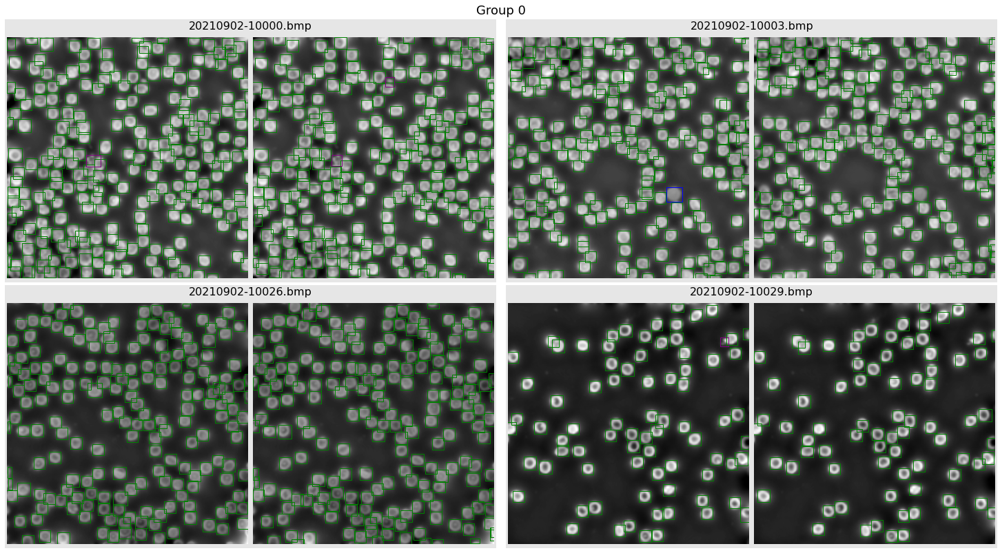

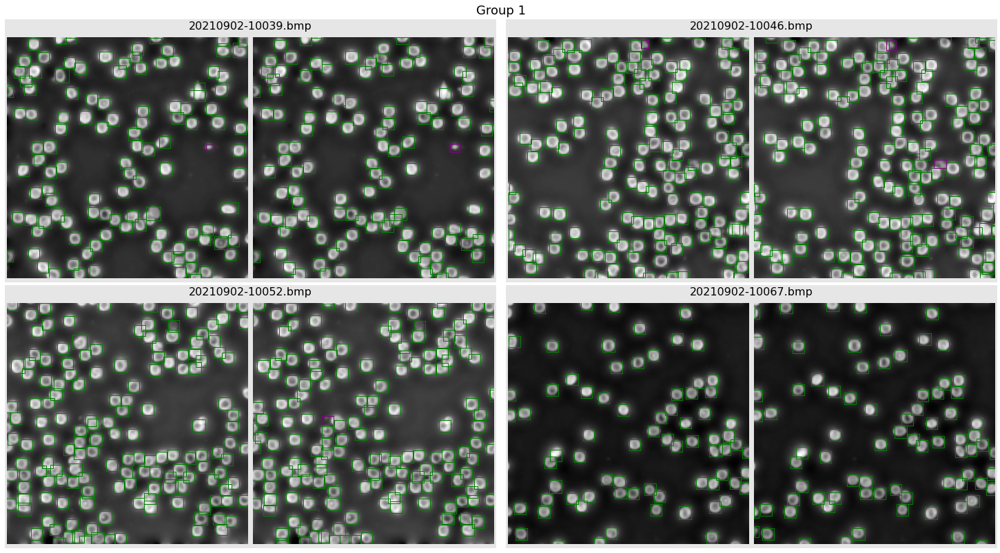

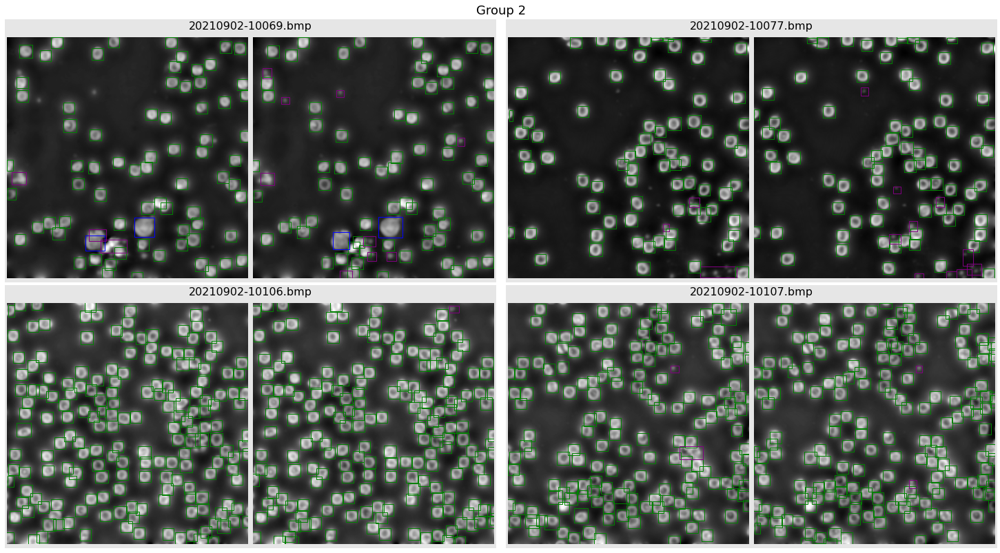

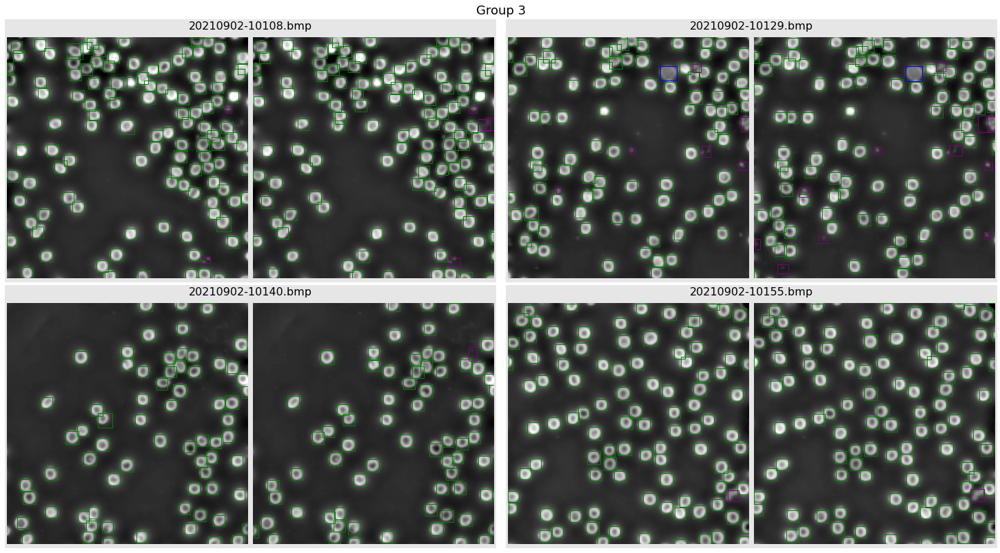

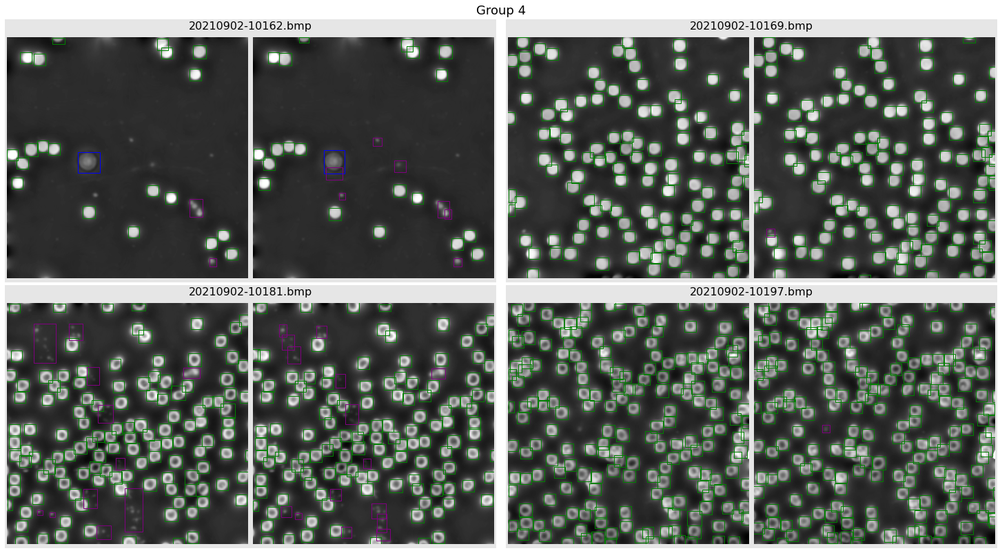

...

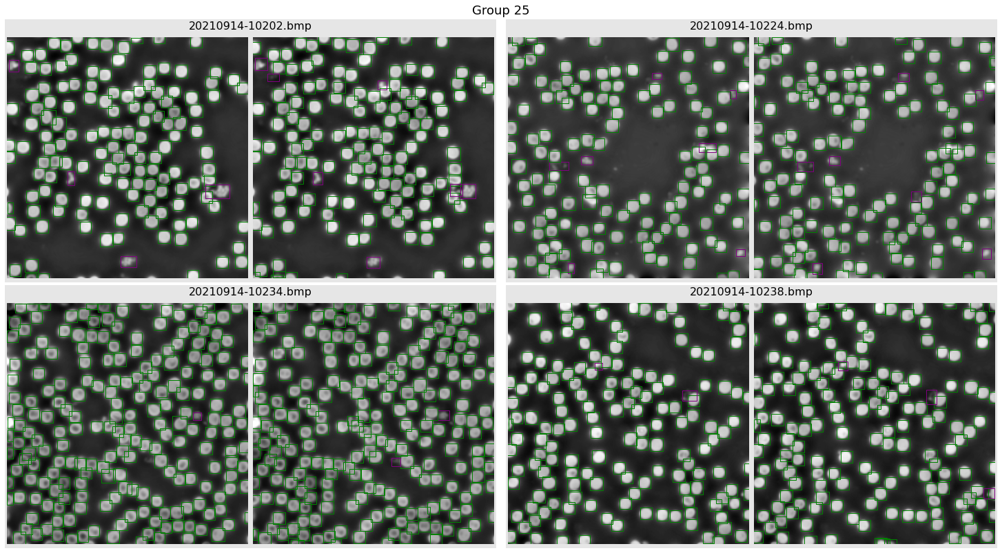

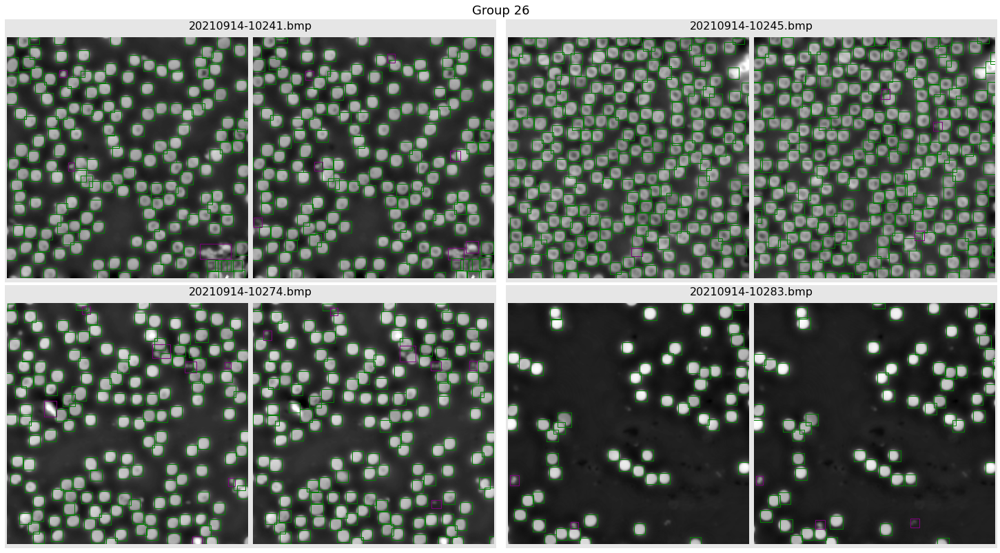

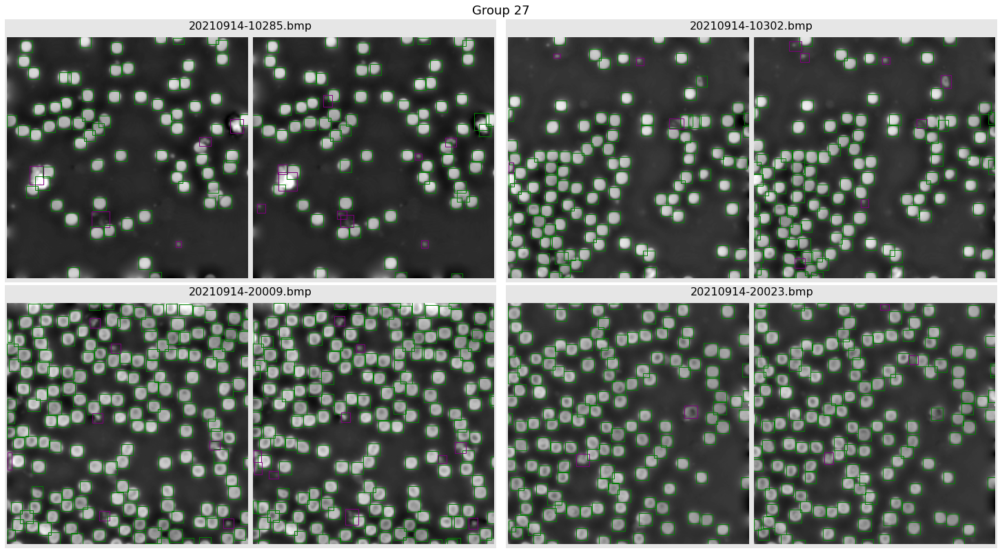

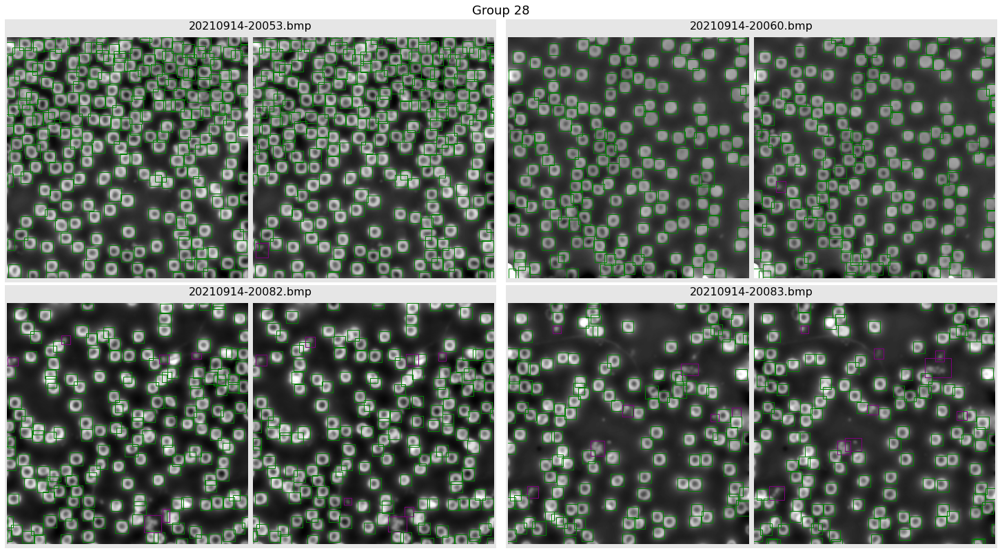

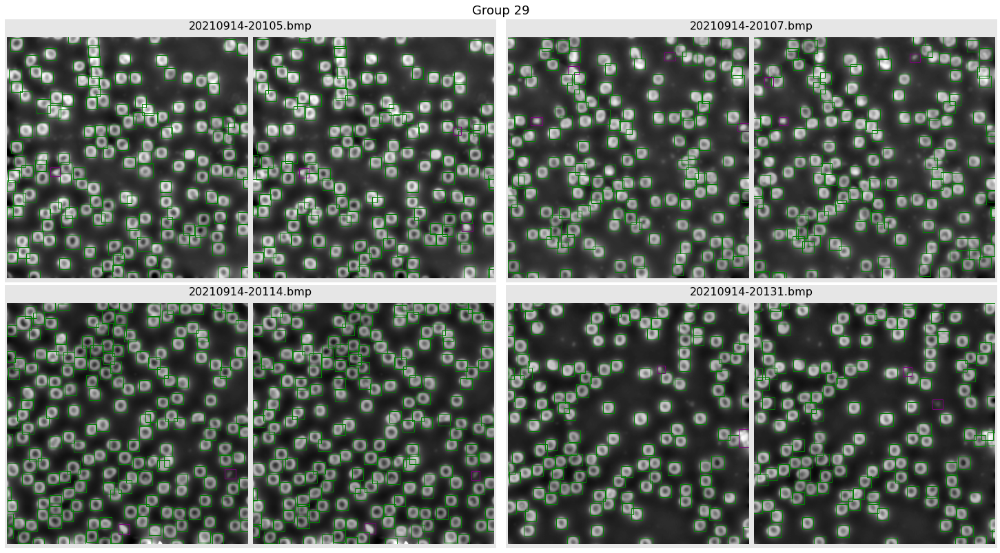

In [6]:
# Grouped Comparisons Visulization
def axis_rectangle_labeling(axes, coordinates, colors=("g","b", "purple"), lw=None, fill=False):
    """ Labeling axes with given bounding boxes. """
    for x, y, w, h, lbl in coordinates:
        rect = plt.Rectangle((x-w/2, y-h/2), w, h, color=colors[int(lbl)], fill=fill, linewidth=lw)
        axes.add_patch(rect)
    return axes

def four_group_recognition_comparison(truth_group, recognition_group, phases, filenames, suptitle=None):
    fig = plt.figure(constrained_layout=True, figsize=(20, 11))
    fig.suptitle(suptitle, fontsize=18)
    subfigs = fig.subfigures(2, 2, wspace=0.02, hspace=0.01)
    for i, (truth, recognition, phase, fname) in enumerate(zip(truth_group, recognition_group, phases, filenames)):
        cur_subfig = subfigs[i//2, i%2]
        cur_subfig.suptitle(basename(fname), fontsize=16)
        cur_subfig.set_facecolor('0.9')
        cur_axs = cur_subfig.subplots(1, 2, gridspec_kw={"wspace": 0.01})
        for k, ax in enumerate(cur_axs):
            ax.imshow(phase, cmap="gray")
            ax.set_xticks([])
            ax.set_yticks([])
            for sp in ["top", "bottom", "left", "right"]:
                ax.spines[sp].set_visible(False)
            axis_rectangle_labeling(ax, (truth, recognition)[k])

for i in range(len(analyzer["Truths"])//4):
    four_group_recognition_comparison(analyzer["Truths"][i*4:(i+1)*4], analyzer["BSRNet"][i*4:(i+1)*4], 
                                      analyzer["phase"][i*4:(i+1)*4], analyzer["source_fnames"][i*4:(i+1)*4], "Group %d" % i)

### Specified Samples Visualization

In [4]:
# Load yolo model
model_fname = join(ModelRoot, "plan_8.4\\yolov6_1227-171916.pth")
yolo_model = torch.load(model_fname).to("cuda")

# Analyze entire test dataset
predParams = {"image_shape": (DST_IMGSZ, DST_IMGSZ), 
              "grid_size": GRIDSZ,
              "anchors": ANCHORS, 
              "n_class": N_CLASSES, 
              "device": "cpu",
              "nms_threshold": 0.2, 
              "conf_threshold": 0.9}

dataLoader = create_dataloader(SET202109_FILENAME, "test", 8, dataset_obj=NameRememberedDataset)
analyzer = RecognitionAnalyzer(join(ProjectRoot, 'caches\\acc_compare_set202109_1211-141810.pkl'))

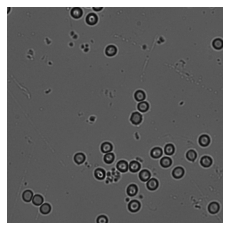

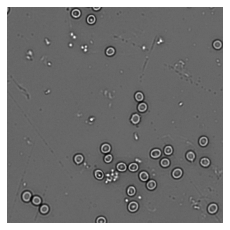

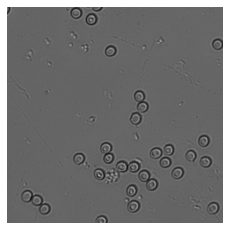

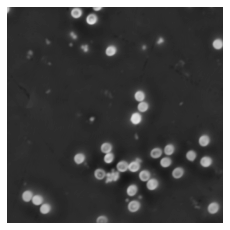

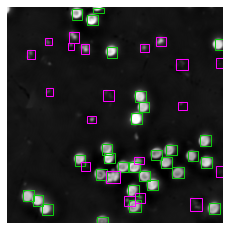

...

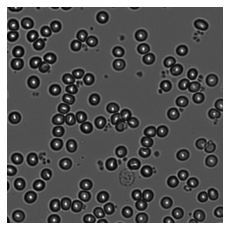

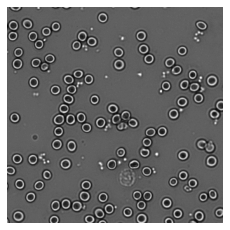

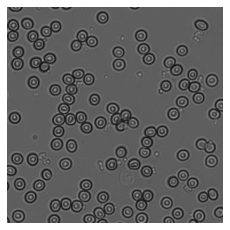

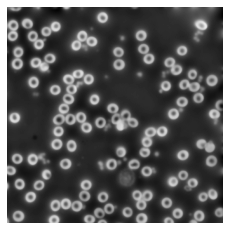

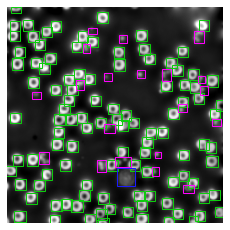

In [40]:
def high_contrast_display(img): return clip(img, quantile(img, 5e-3), quantile(img, 0.999))

def single_sample_visualization(arr, boxes, figsize=(3, 3),
                                colors=((0.05, 0.8, 0.05), (0.1, 0.1, 1.), "fuchsia")):
    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(arr, cmap="gray")
    ax.set_xticks([])
    ax.set_yticks([])
    for sp in ["top", "bottom", "left", "right"]:
        ax.spines[sp].set_visible(False)
    for x, y, w, h, lbl in boxes:
        rect = plt.Rectangle((x-w//2, y-h//2), w, h, color=colors[int(lbl)], fill=False, lw=1.)
        ax.add_patch(rect)
    plt.tight_layout(pad=0)
    return fig, ax


def get_cooresponding_multimodals(fname, dataset_root=DatasetRoot,
                                  minus_dir="Set-202109-1\\minus\\test",
                                  plus_dir="Set-202109-1\\plus\\test",
                                  infocus_dir="Set-202109-1\\focus\\test",
                                  phase_dir="Set-202109-1\\phase\\test",):
    minus_fullpath = join(dataset_root, minus_dir)
    plus_fullpath = join(dataset_root, plus_dir)
    infocus_fullpath = join(dataset_root, infocus_dir)
    phase_fullpath = join(dataset_root, phase_dir)
    multimodals = []
    for fullpath in (minus_fullpath, plus_fullpath, infocus_fullpath, phase_fullpath):
        image_fullname = join(fullpath, fname + ".bmp")
        image = imread(image_fullname, flags=IMREAD_GRAYSCALE)
        image = img_as_float32(image)
        multimodals.append(image)
    return multimodals
    

def output_multimodal_image(arr, fig_savename="", figsize=(3, 3), val_range=(0.0, 1.), dpi=200):
    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(arr, cmap="gray", vmin=val_range[0], vmax=val_range[1])
    ax.set_xticks([])
    ax.set_yticks([])
    for sp in ["top", "bottom", "left", "right"]:
        ax.spines[sp].set_visible(False)
    plt.tight_layout(pad=0.)
    if fig_savename:
        plt.savefig(fig_savename, dpi=dpi)

visualized_sample_fnames = ["20210902-10358", "20210902-10365", "20210914-10029"]

figures_fpath = join(InvesRoot, "figures\毕设")
dataset_fprefix = join(DatasetRoot, "Set-202109-1\\phase\\test")
for sp_fname in visualized_sample_fnames:
    # Funding the sample index by filename
    sp_idx = analyzer["source_fnames"].index(join(dataset_fprefix, sp_fname + ".bmp"))
    # Merge the boxes of Platelets for BSRNet recognitions
    analyzer.data["BSRNet"][sp_idx] = merge_platelets_to_assembles(analyzer.data["BSRNet"][sp_idx])
    
    # Datas
    sample_multimodals = get_cooresponding_multimodals(sp_fname)
    multimodal_savenames = [join(figures_fpath, sp_fname + modal_str + ".tif")
                            for modal_str in ("_minus", "_plus", "_infocus", "_phase")]
    for modal, savename in zip(sample_multimodals, multimodal_savenames):
        output_multimodal_image(modal, savename)
    phase, bsrnet = [analyzer[sp_idx].get(k) for k in ("phase", "BSRNet")]
    fig, ax = single_sample_visualization(high_contrast_display(phase), bsrnet)
    savename = join(figures_fpath, sp_fname+"_recognitions.tif")
    plt.savefig(savename, dpi=200)

### Type Accuracy  
Confusion matrix

In [2]:
analyzer_source_filename = join(ProjectRoot, 'caches\\acc_compare_set202109_1211-141810.pkl')
analyzer = RecognitionAnalyzer(source_filename=analyzer_source_filename)

def high_contrast_display(img): return clip(img, quantile(img, 5e-3), quantile(img, 0.999))

In [14]:
# Visualizing Help Functions
def specified_recognitions_visualize(phase, coordinates_maps, title, colors=("g", "b", "fuchsia")):
    fig, axis = plt.subplots(1, len(coordinates_maps), figsize=(5*len(coordinates_maps), 5.5), constrained_layout=True)
    fig.suptitle(title, fontsize=14)
    for ax, (key, coordinates) in zip(axis, coordinates_maps):
        ax.set_xticks([])
        ax.set_yticks([])
        for sp in ["top", "bottom", "left", "right"]:
            ax.spines[sp].set_visible(False)
        ax.set_title(key, fontsize=12)
        ax.imshow(high_contrast_display(phase), cmap="gray")
        for x, y, w, h, lb in coordinates:
            rect = plt.Rectangle((x-w/2, y-h/2), w, h, color=colors[int(lb)], fill=False, lw=1.5)
            ax.add_patch(rect)
        
def recognition_figures_produce(image, coordinates, save_fname, colors=("g", (0.3, 0.3, 1.), "fuchsia"), dpi=400):
    fig, ax = plt.subplots(figsize=(2, 2))
    ax.imshow(high_contrast_display(image), cmap="gray")
    ax.set_xticks([])
    ax.set_yticks([])
    for sp in ["top", "bottom", "left", "right"]:
        ax.spines[sp].set_visible(False)
    for x, y, w, h, lbl in coordinates:
        rect = plt.Rectangle((x-w//2, y-h//2), w, h, lw=1.5, color=colors[int(lbl)], fill=False)
        ax.add_patch(rect)
    plt.tight_layout(pad=0)
    plt.savefig(save_fname, dpi=dpi)

20210902-10181.bmp  Truth: 11 BSRNet: 11
20210902-20017.bmp  Truth: 16 BSRNet: 16
20210902-20315.bmp  Truth: 1 BSRNet: 1
20210914-10162.bmp  Truth: 1 BSRNet: 1
20210902-20269.bmp  Truth: 2 BSRNet: 2
20210902-20327.bmp  Truth: 159 BSRNet: 159
20210914-10162.bmp  Truth: 100 BSRNet: 102
20210914-10202.bmp  Truth: 138 BSRNet: 141


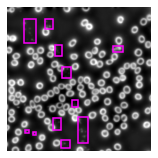

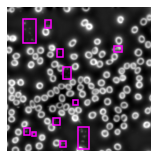

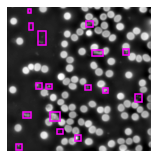

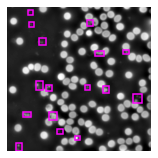

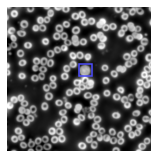

...

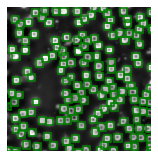

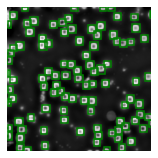

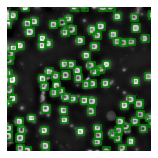

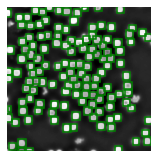

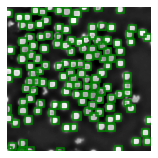

In [15]:
figures_fpath = join(InvesRoot, "figures\\density_impact\\type_accuracy")
sample_fnames = ["20210902-10181.bmp", "20210902-20017.bmp",                        # Platelets
                 "20210902-20315.bmp", "20210914-10162.bmp", "20210902-20269.bmp",  # WBC
                 "20210902-20327.bmp", "20210914-10162.bmp", "20210914-10202.bmp"]  # RBC

def merge_platelets_to_assembles(boxes, platelet_flag=2.):
    platelet_indexes, = np.where(boxes[:, 4] == platelet_flag)
    platelet_boxes = boxes[platelet_indexes]
    non_revised_boxes = np.delete(boxes, platelet_indexes, axis=0)
    assembled_boxes = iou_assembling(platelet_boxes)
    assembles = []
    for boxes in assembled_boxes:
        assembles.append(boxes_area_merge(boxes))
    return np.concatenate([non_revised_boxes, np.array(assembles)])

overviews = {}
dataset_fprefix = join(DatasetRoot, "Set-202109-1\\phase\\test")
for sp_fname, focused_type in zip(sample_fnames, [2, 2, 1, 1, 1, 0, 0, 0]):
    # Funding the sample index by filename
    sp_idx = analyzer["source_fnames"].index(join(dataset_fprefix, sp_fname))
    
    # Merge the boxes of Platelets for BSRNet recognitions
    analyzer.data["BSRNet"][sp_idx] = merge_platelets_to_assembles(analyzer.data["BSRNet"][sp_idx])
    
    # Take the phase image, truth data and recognitions for specified sample
    phase, truths, bsrnet = [analyzer[sp_idx].get(k) for k in ("phase", "Truths", "BSRNet")]
    
    # Extracts the Truth and Prediction number, and Records the total counts to a dict
    n_truths = analyzer.counter["Truths"]["statistics"][sp_idx][focused_type]
    n_bsrnet = analyzer.counter["BSRNet"]["statistics"][sp_idx][focused_type]
    overviews.update({sp_fname.rstrip(".bmp"): np.array([n_truths, n_bsrnet])})
    
    # Picks the bounding boxes with specific cell type
    truths_spec = truths[truths[:, 4] == float(focused_type)]
    bsrnet_spec = bsrnet[bsrnet[:, 4] == float(focused_type)]
    # Produce Recognitions for Specified Cell Type 
    truths_img_fname = join(figures_fpath, sp_fname.rstrip(".bmp")+"_truths.tif")
    bsrnet_img_fname = join(figures_fpath, sp_fname.rstrip(".bmp")+"_bsrnet.tif")
    print(sp_fname, f" Truth: {len(truths_spec)} BSRNet: {len(bsrnet_spec)}")
    recognition_figures_produce(phase, truths_spec, truths_img_fname)
    recognition_figures_produce(phase, bsrnet_spec, bsrnet_img_fname)

### BSRNet Recognitions

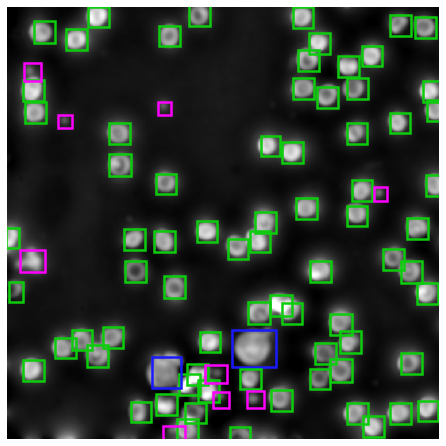

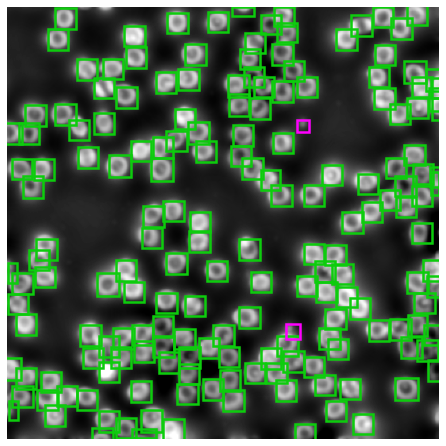

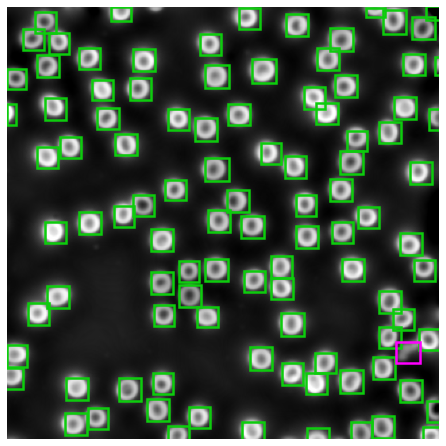

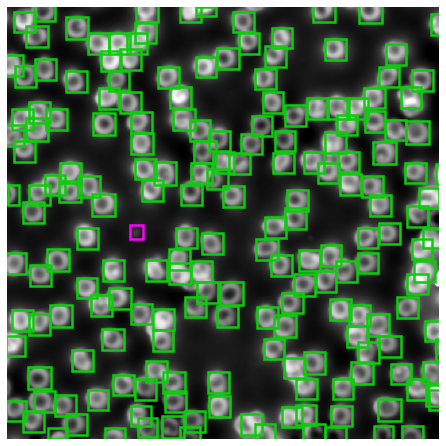

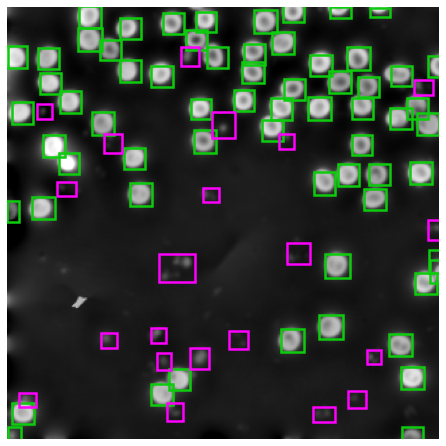

...

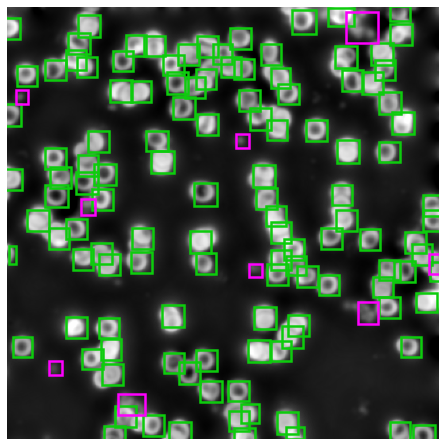

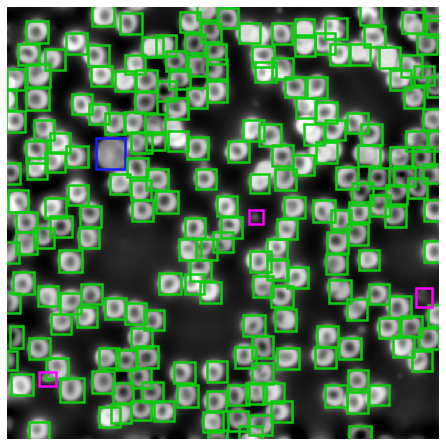

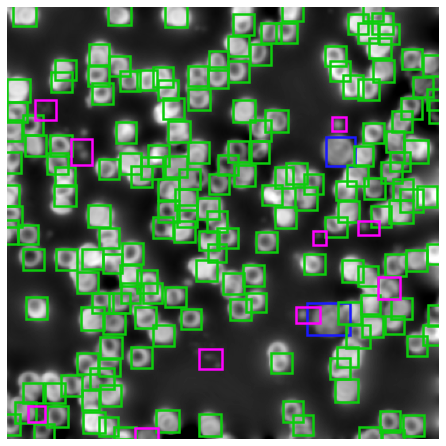

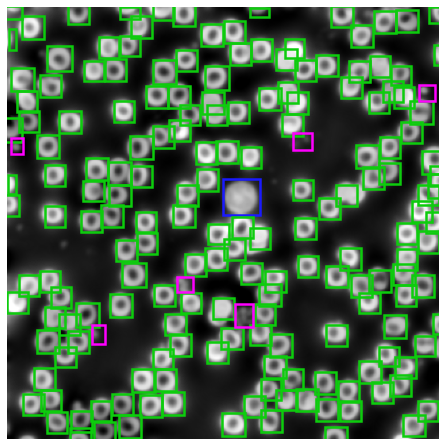

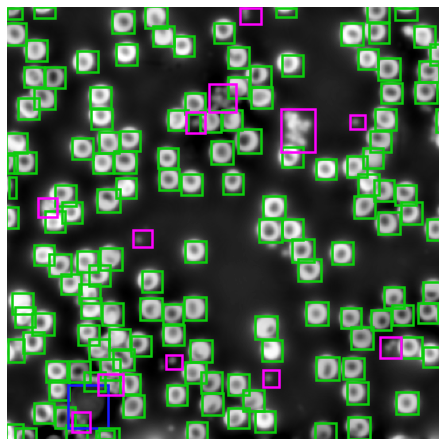

In [24]:
displayed_sample_names = ("20210902-10069", "20210902-10107", "20210902-10155", 
                          "20210902-10197", "20210902-10294", "20210902-10326", 
                          "20210902-20151", "20210902-20254", "20210902-20294", 
                          "20210902-20269", "20210902-20315", "20210902-20367")

def single_sample_visualization(arr, boxes, scale=8, figsize=(6, 6),
                                colors=((0.05, 0.8, 0.05), (0.1, 0.1, 1.), "fuchsia")):
    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(arr, cmap="gray")
    ax.set_xticks([])
    ax.set_yticks([])
    for sp in ["top", "bottom", "left", "right"]:
        ax.spines[sp].set_visible(False)
    for x, y, w, h, lbl in boxes:
        rect = plt.Rectangle((x-w//2, y-h//2), w, h, color=colors[int(lbl)], fill=False, lw=2.5)
        ax.add_patch(rect)
    plt.tight_layout(pad=0.)
    return fig, ax

figures_fpath = join(InvesRoot, "figures\\density_impact\\displayed")
dataset_fprefix = join(DatasetRoot, "Set-202109-1\\phase\\test")
for sp_fname in displayed_sample_names:
    # Funding the sample index by filename
    sp_idx = analyzer["source_fnames"].index(join(dataset_fprefix, sp_fname + ".bmp"))
    # Merge the boxes of Platelets for BSRNet recognitions
    analyzer.data["BSRNet"][sp_idx] = merge_platelets_to_assembles(analyzer.data["BSRNet"][sp_idx])
    
    # Datas
    phase, bsrnet = [analyzer[sp_idx].get(k) for k in ("phase", "BSRNet")]
    fig, ax = single_sample_visualization(high_contrast_display(phase), bsrnet)
    savename = join(figures_fpath, sp_fname+".tif")
    plt.savefig(savename, dpi=200)

### Conclusions

accuracys:  
    rbc: 99.66%  
    wbc: 100.0%  
    platelet: 63.16%